# Описание набора данных
Датасет включает в себя фото окон. Данные были собраны при помощи камеры смартфона и сервиса Google Maps. Всего в датасете 1020 фотографий.

# Загрузка и предварительная обработка данных
Фото были аннотированы с помощью сервиса CVAT.

Подключение Google Диска к окружению

In [1]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/my_dataset_yolo
%ls # Отображение файлов в текущем каталоге

Mounted at /content/drive
/content/drive/MyDrive/my_dataset_yolo
confusion_matrix_normalized.png  labels/               runs/                  val_batch1_pred.jpg
confusion_matrix.png             my_dataset_yolo.yaml  tracked_output.mp4
images/                          results.png           val_batch1_labels.jpg


In [2]:
%pip install ultralytics
from ultralytics import YOLO # Импорт библиотеки

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 780.7/780.7 kB 7.3 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-m

In [ ]:
!pip install pyyaml

In [ ]:
import yaml

# Чтение текущих настроек
with open('/root/.config/Ultralytics/settings.yaml', 'r') as file:
    config = yaml.safe_load(file)

In [ ]:
# Обновление пути к директории с датасетами
config['datasets_dir'] = '/content/drive/MyDrive/my_dataset_yolo'

In [ ]:
# Запись обновленных настроек обратно в файл
with open('/root/.config/Ultralytics/settings.yaml', 'w') as file:
    yaml.safe_dump(config, file)

In [ ]:
# Вывод содержимого файла конфигурации для проверки изменений
!cat /root/.config/Ultralytics/settings.yaml

api_key: ''
clearml: true
comet: true
datasets_dir: /content/drive/MyDrive/my_dataset_yolo
dvc: true
hub: true
mlflow: true
neptune: true
openai_api_key: ''
raytune: true
runs_dir: runs
settings_version: 0.0.4
sync: true
tensorboard: true
uuid: 569f3ba64b326db489132663f79cd37279811de477381b83ac131e6cdd129cbb
wandb: true
weights_dir: weights


# Постановка задачи и построение модели
Задача - обучить модель для детекции окон. Работа выполняется в рамках проекта по созданию дрона-мойщика. В данной задаче предполагается обучение на собственном датасете и сравнение результатов моделей YOLOv8 и YOLO9c. Будет проведено сравнение метрик, а также использование обученной модели на реальном примере.

In [ ]:
%load_ext tensorboard # Загрузка расширения TensorBoard
%tensorboard --logdir runs/detect/train # Запуск TensorBoard

<IPython.core.display.Javascript object>

In [ ]:
model = YOLO('yolov8m.pt') # Загрузка предобученной модели YOLOv8m
results = model.train(data='/content/drive/MyDrive/my_dataset_yolo/my_dataset_yolo.yaml', epochs=100, imgsz=640, model='yolov8m.pt') # Обучение модели на собственном наборе данных

100%|██████████| 49.7M/49.7M [00:00<00:00, 219MB/s]


Ultralytics YOLOv8.2.28 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/drive/MyDrive/my_dataset_yolo/my_dataset_yolo.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_

100%|██████████| 755k/755k [00:00<00:00, 22.3MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 90.7MB/s]
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/my_dataset_yolo/labels/train... 765 images, 14 backgrounds, 0 corrupt: 100%|██████████| 765/765 [06:42<00:00,  1.90it/s]


train: New cache created: /content/drive/MyDrive/my_dataset_yolo/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/drive/MyDrive/my_dataset_yolo/labels/val... 255 images, 9 backgrounds, 0 corrupt: 100%|██████████| 255/255 [01:56<00:00,  2.20it/s]


val: New cache created: /content/drive/MyDrive/my_dataset_yolo/labels/val.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      8.04G     0.9048      1.489      1.063        133        640: 100%|██████████| 48/48 [01:10<00:00,  1.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:26<00:00,  3.32s/it]

                   all        255       1589    0.00675      0.295    0.00453     0.0016



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      7.58G     0.8384      1.159       1.01        200        640: 100%|██████████| 48/48 [01:00<00:00,  1.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:20<00:00,  2.60s/it]

                   all        255       1589     0.0397      0.454     0.0283     0.0151



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      7.55G     0.8802      1.071      1.051         92        640: 100%|██████████| 48/48 [01:01<00:00,  1.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:27<00:00,  3.43s/it]

                   all        255       1589     0.0619      0.266     0.0365     0.0195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100       7.3G     0.8512     0.9892      1.033         91        640: 100%|██████████| 48/48 [01:00<00:00,  1.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:21<00:00,  2.67s/it]

                   all        255       1589     0.0972      0.192     0.0547      0.028



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      7.58G      0.808     0.9255     0.9984        252        640: 100%|██████████| 48/48 [00:59<00:00,  1.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.86s/it]

                   all        255       1589      0.272      0.389      0.183      0.113



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100       7.3G      0.816     0.9453      1.012        263        640: 100%|██████████| 48/48 [01:00<00:00,  1.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.92s/it]

                   all        255       1589       0.66      0.589      0.654      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      7.64G     0.7876     0.8693     0.9914        125        640: 100%|██████████| 48/48 [01:00<00:00,  1.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:19<00:00,  2.48s/it]

                   all        255       1589      0.677      0.621      0.672       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      8.05G     0.7354     0.8575     0.9685        124        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.79s/it]

                   all        255       1589      0.747      0.592      0.715      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      8.02G     0.7374     0.8195     0.9711        313        640: 100%|██████████| 48/48 [01:00<00:00,  1.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.77s/it]

                   all        255       1589      0.718      0.689      0.717      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100       7.3G     0.7073     0.7714     0.9596        126        640: 100%|██████████| 48/48 [01:08<00:00,  1.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:24<00:00,  3.04s/it]

                   all        255       1589      0.739      0.705      0.786      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100       7.9G     0.7012     0.7475     0.9528        162        640: 100%|██████████| 48/48 [00:59<00:00,  1.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.90s/it]

                   all        255       1589      0.669      0.637      0.699      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      8.01G     0.6953     0.7924     0.9474        301        640: 100%|██████████| 48/48 [01:13<00:00,  1.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:25<00:00,  3.13s/it]

                   all        255       1589      0.716      0.652      0.746      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      7.68G      0.698     0.7369     0.9525        261        640: 100%|██████████| 48/48 [01:01<00:00,  1.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.92s/it]

                   all        255       1589      0.708      0.685      0.763      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      7.26G     0.6699      0.723     0.9518        135        640: 100%|██████████| 48/48 [01:07<00:00,  1.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:21<00:00,  2.74s/it]

                   all        255       1589      0.739      0.686      0.758      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      6.96G     0.6597     0.7402     0.9495        103        640: 100%|██████████| 48/48 [01:05<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.78s/it]

                   all        255       1589      0.742      0.702      0.785      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      8.23G     0.6571     0.7083     0.9347        135        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.79s/it]

                   all        255       1589       0.72      0.695      0.781      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      7.85G     0.6312     0.6718     0.9255        164        640: 100%|██████████| 48/48 [01:01<00:00,  1.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.76s/it]

                   all        255       1589      0.687      0.748      0.788      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      7.67G     0.6189     0.6774     0.9293        124        640: 100%|██████████| 48/48 [01:00<00:00,  1.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:20<00:00,  2.57s/it]

                   all        255       1589      0.768      0.707      0.788      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      7.68G     0.6267     0.6691     0.9264        246        640: 100%|██████████| 48/48 [01:01<00:00,  1.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:20<00:00,  2.59s/it]

                   all        255       1589      0.788      0.676      0.778      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      7.64G     0.6068     0.6359     0.9187        130        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.96s/it]

                   all        255       1589       0.69       0.69      0.752      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      7.06G     0.5875     0.6383     0.9111        236        640: 100%|██████████| 48/48 [00:57<00:00,  1.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.94s/it]

                   all        255       1589      0.789      0.698      0.785      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      8.03G     0.6018     0.6793     0.9124        124        640: 100%|██████████| 48/48 [01:05<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:24<00:00,  3.03s/it]

                   all        255       1589      0.737      0.667       0.75       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100       7.9G     0.5614     0.6136      0.908         89        640: 100%|██████████| 48/48 [01:02<00:00,  1.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:26<00:00,  3.32s/it]

                   all        255       1589       0.77      0.732      0.806      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      8.11G     0.5844      0.622     0.9117        155        640: 100%|██████████| 48/48 [01:09<00:00,  1.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.95s/it]

                   all        255       1589      0.819      0.688      0.794      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      7.81G     0.5824      0.629     0.9159        163        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.95s/it]

                   all        255       1589      0.784      0.738      0.822      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      7.56G     0.5618     0.5908     0.9015        100        640: 100%|██████████| 48/48 [01:07<00:00,  1.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:24<00:00,  3.01s/it]

                   all        255       1589      0.741       0.74      0.806      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      8.06G      0.573     0.5906     0.9057        196        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:26<00:00,  3.30s/it]

                   all        255       1589      0.793      0.702      0.794      0.656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      8.42G     0.5684     0.5457     0.8972        134        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.92s/it]

                   all        255       1589      0.798      0.728      0.811      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100       7.9G     0.5615      0.551     0.8956        220        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:27<00:00,  3.46s/it]

                   all        255       1589      0.738      0.775      0.816      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      7.89G       0.58     0.5702     0.9059        135        640: 100%|██████████| 48/48 [01:05<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.82s/it]

                   all        255       1589      0.763      0.704      0.783      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      7.41G     0.5734     0.5497     0.9039        137        640: 100%|██████████| 48/48 [01:03<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:25<00:00,  3.15s/it]

                   all        255       1589      0.741      0.725      0.769      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      7.99G     0.5344     0.5138     0.8884        237        640: 100%|██████████| 48/48 [01:04<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.93s/it]

                   all        255       1589      0.794      0.729       0.81       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      7.93G     0.5345     0.4904     0.8829        192        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:21<00:00,  2.72s/it]

                   all        255       1589      0.759      0.742       0.82      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      7.33G     0.5445     0.4995     0.8919        147        640: 100%|██████████| 48/48 [01:09<00:00,  1.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:27<00:00,  3.42s/it]

                   all        255       1589      0.741      0.727      0.783      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      7.55G     0.5301     0.5045     0.8789        204        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.85s/it]

                   all        255       1589      0.754      0.753      0.799      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      7.06G      0.517     0.5013     0.8831        136        640: 100%|██████████| 48/48 [01:12<00:00,  1.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.84s/it]

                   all        255       1589      0.785      0.748      0.828      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      8.24G     0.5107     0.4934     0.8795        167        640: 100%|██████████| 48/48 [01:02<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:25<00:00,  3.15s/it]

                   all        255       1589      0.758      0.738      0.804      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      7.62G     0.5294     0.4804     0.8741        200        640: 100%|██████████| 48/48 [01:07<00:00,  1.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:24<00:00,  3.12s/it]

                   all        255       1589      0.805      0.718       0.82      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      7.91G     0.5158     0.4689     0.8757         90        640: 100%|██████████| 48/48 [01:02<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:24<00:00,  3.07s/it]

                   all        255       1589      0.773      0.721      0.809      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100       7.4G     0.5219     0.4806     0.8766        101        640: 100%|██████████| 48/48 [01:05<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:27<00:00,  3.44s/it]

                   all        255       1589      0.746      0.763      0.811      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      7.61G      0.515     0.4654     0.8753         83        640: 100%|██████████| 48/48 [01:05<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:28<00:00,  3.59s/it]

                   all        255       1589      0.753      0.752       0.82      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      7.65G     0.5057     0.4617     0.8762        130        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:25<00:00,  3.15s/it]

                   all        255       1589      0.798      0.712      0.796      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      7.95G     0.4911     0.4347     0.8664        191        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:30<00:00,  3.84s/it]

                   all        255       1589      0.714      0.705      0.779      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      8.08G     0.5077     0.4402     0.8723         97        640: 100%|██████████| 48/48 [01:02<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:25<00:00,  3.21s/it]

                   all        255       1589      0.754      0.741      0.816      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      7.31G     0.4723     0.4137     0.8666        265        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:28<00:00,  3.61s/it]

                   all        255       1589      0.722      0.753      0.801      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      7.92G     0.4905     0.4116     0.8643         89        640: 100%|██████████| 48/48 [01:04<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.92s/it]

                   all        255       1589      0.754      0.783      0.836       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      7.77G      0.508     0.4374     0.8703        171        640: 100%|██████████| 48/48 [01:07<00:00,  1.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:24<00:00,  3.09s/it]

                   all        255       1589       0.74      0.756      0.811      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      7.59G     0.4933     0.4136     0.8572        142        640: 100%|██████████| 48/48 [01:01<00:00,  1.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:25<00:00,  3.23s/it]

                   all        255       1589      0.803      0.743      0.834      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      8.45G     0.4751     0.4105     0.8642        213        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.84s/it]

                   all        255       1589      0.769      0.736      0.812       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      7.96G     0.4681     0.4056     0.8602        131        640: 100%|██████████| 48/48 [01:03<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.89s/it]

                   all        255       1589       0.78      0.753      0.836      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      7.57G     0.4639     0.3789     0.8552        144        640: 100%|██████████| 48/48 [01:10<00:00,  1.46s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:26<00:00,  3.25s/it]

                   all        255       1589      0.822      0.725       0.83      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      7.67G     0.4486      0.387     0.8602         90        640: 100%|██████████| 48/48 [01:01<00:00,  1.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:25<00:00,  3.16s/it]

                   all        255       1589       0.79      0.746      0.837      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      8.39G      0.472     0.3848     0.8573        119        640: 100%|██████████| 48/48 [01:09<00:00,  1.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:24<00:00,  3.06s/it]

                   all        255       1589      0.757      0.744      0.816      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      7.65G     0.4691     0.3979     0.8631         99        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:24<00:00,  3.04s/it]

                   all        255       1589      0.795      0.749      0.836      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      7.12G     0.4623     0.3916      0.855        186        640: 100%|██████████| 48/48 [01:08<00:00,  1.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:24<00:00,  3.11s/it]

                   all        255       1589      0.823      0.719      0.826      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      7.86G     0.4528     0.3668     0.8635        116        640: 100%|██████████| 48/48 [01:06<00:00,  1.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.92s/it]

                   all        255       1589       0.83       0.77      0.852      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      7.86G     0.4567     0.3566     0.8515        251        640: 100%|██████████| 48/48 [01:06<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.85s/it]

                   all        255       1589      0.741       0.77      0.788      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      7.87G     0.4574     0.3619     0.8458        187        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.99s/it]

                   all        255       1589      0.733      0.801      0.828      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      7.43G     0.4542     0.3495     0.8537        115        640: 100%|██████████| 48/48 [01:12<00:00,  1.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:21<00:00,  2.72s/it]

                   all        255       1589      0.798      0.775      0.849      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      7.63G     0.4327      0.345     0.8462        157        640: 100%|██████████| 48/48 [01:02<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:26<00:00,  3.35s/it]

                   all        255       1589      0.791      0.759      0.823      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      7.71G     0.4374     0.3362     0.8515        164        640: 100%|██████████| 48/48 [01:06<00:00,  1.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  3.00s/it]

                   all        255       1589      0.787      0.738       0.83        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      7.31G     0.4257     0.3325     0.8403        138        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:27<00:00,  3.39s/it]

                   all        255       1589      0.746      0.764      0.826      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      7.83G     0.4357     0.3439     0.8515        174        640: 100%|██████████| 48/48 [01:04<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:25<00:00,  3.21s/it]

                   all        255       1589      0.776      0.743      0.826      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      8.46G     0.4314     0.3412     0.8468        122        640: 100%|██████████| 48/48 [01:04<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:24<00:00,  3.06s/it]

                   all        255       1589      0.788      0.734      0.829      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      8.34G     0.4275     0.3339     0.8496        111        640: 100%|██████████| 48/48 [01:05<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:25<00:00,  3.22s/it]

                   all        255       1589       0.81       0.75      0.838      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      8.56G     0.4276     0.3244     0.8379         76        640: 100%|██████████| 48/48 [01:02<00:00,  1.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:24<00:00,  3.02s/it]

                   all        255       1589      0.819      0.762      0.843       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      8.24G     0.4375     0.3407     0.8439        135        640: 100%|██████████| 48/48 [01:07<00:00,  1.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:26<00:00,  3.36s/it]

                   all        255       1589      0.776      0.795      0.851      0.739



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      7.68G     0.4209     0.3208     0.8464        143        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.87s/it]

                   all        255       1589       0.79      0.767      0.836      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      7.64G     0.4299      0.317     0.8409        148        640: 100%|██████████| 48/48 [01:08<00:00,  1.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.78s/it]

                   all        255       1589      0.804      0.768      0.853      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      8.03G     0.4258     0.3199     0.8436        123        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:28<00:00,  3.51s/it]

                   all        255       1589      0.779       0.79      0.852      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      7.38G     0.4155     0.3077     0.8411        162        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:24<00:00,  3.00s/it]

                   all        255       1589      0.767      0.778      0.839      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      7.94G     0.4061     0.3154     0.8388        148        640: 100%|██████████| 48/48 [01:06<00:00,  1.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.77s/it]

                   all        255       1589      0.761      0.789      0.836       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      7.82G     0.4097     0.3074     0.8358        100        640: 100%|██████████| 48/48 [01:07<00:00,  1.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.96s/it]

                   all        255       1589      0.775      0.775      0.838       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      7.58G     0.3965     0.2967     0.8374        142        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.84s/it]

                   all        255       1589      0.779      0.752      0.833      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      7.66G     0.3959     0.2988     0.8362        132        640: 100%|██████████| 48/48 [01:05<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:25<00:00,  3.16s/it]

                   all        255       1589      0.815      0.771      0.852       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      7.32G     0.3976     0.2893     0.8354        146        640: 100%|██████████| 48/48 [01:02<00:00,  1.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:21<00:00,  2.67s/it]

                   all        255       1589      0.723      0.811       0.84       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      7.64G     0.3934     0.2815     0.8401         78        640: 100%|██████████| 48/48 [01:05<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:27<00:00,  3.49s/it]

                   all        255       1589      0.829      0.768      0.857      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      7.99G     0.3993     0.2926     0.8325        109        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:21<00:00,  2.72s/it]

                   all        255       1589      0.799      0.782      0.847      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      8.03G     0.3929     0.2794     0.8286        115        640: 100%|██████████| 48/48 [01:03<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:25<00:00,  3.14s/it]

                   all        255       1589       0.79      0.757      0.836      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      7.28G     0.3969     0.2859      0.831        109        640: 100%|██████████| 48/48 [01:02<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.82s/it]

                   all        255       1589      0.797      0.751      0.842      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      7.03G     0.3869     0.2722     0.8313        193        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:27<00:00,  3.39s/it]

                   all        255       1589      0.827      0.788      0.864      0.754



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      7.64G     0.3922      0.278     0.8408        111        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.95s/it]

                   all        255       1589       0.81      0.756      0.849      0.742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      7.66G     0.3791     0.2652     0.8287        154        640: 100%|██████████| 48/48 [01:06<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:26<00:00,  3.37s/it]

                   all        255       1589      0.799      0.784      0.853      0.746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      7.71G     0.3904     0.2768     0.8316        119        640: 100%|██████████| 48/48 [01:01<00:00,  1.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:25<00:00,  3.18s/it]

                   all        255       1589      0.764      0.788      0.839      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      7.07G     0.3736     0.2644     0.8289        140        640: 100%|██████████| 48/48 [01:07<00:00,  1.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:24<00:00,  3.07s/it]

                   all        255       1589      0.789      0.779      0.845      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      7.15G     0.3731     0.2599     0.8269        153        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:28<00:00,  3.52s/it]

                   all        255       1589        0.8      0.773      0.853       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      7.82G      0.384      0.264     0.8318        292        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.97s/it]

                   all        255       1589      0.822      0.778      0.863      0.749



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      7.97G     0.3724     0.2548     0.8256        140        640: 100%|██████████| 48/48 [01:02<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:29<00:00,  3.72s/it]

                   all        255       1589      0.819      0.769      0.855      0.746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      7.34G     0.3641     0.2536     0.8292        130        640: 100%|██████████| 48/48 [01:06<00:00,  1.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:26<00:00,  3.29s/it]

                   all        255       1589      0.797      0.774      0.845      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      7.65G     0.3842     0.2567     0.8278        150        640: 100%|██████████| 48/48 [01:07<00:00,  1.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:24<00:00,  3.11s/it]

                   all        255       1589      0.789      0.774      0.844      0.734


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      7.39G     0.3727     0.2529     0.8203        154        640: 100%|██████████| 48/48 [01:15<00:00,  1.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:20<00:00,  2.51s/it]

                   all        255       1589      0.816      0.787      0.861      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      7.56G     0.3669     0.2384     0.8127         60        640: 100%|██████████| 48/48 [01:00<00:00,  1.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:21<00:00,  2.66s/it]

                   all        255       1589      0.781      0.818       0.86       0.75



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      7.59G      0.364     0.2272      0.814        120        640: 100%|██████████| 48/48 [01:06<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:21<00:00,  2.72s/it]

                   all        255       1589      0.831      0.778      0.859       0.75



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      6.92G     0.3483     0.2191     0.8134        135        640: 100%|██████████| 48/48 [01:02<00:00,  1.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:20<00:00,  2.61s/it]

                   all        255       1589      0.822      0.788      0.862      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      7.59G      0.343     0.2142      0.812         49        640: 100%|██████████| 48/48 [01:02<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:21<00:00,  2.73s/it]

                   all        255       1589      0.817      0.801      0.865      0.755



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      7.66G     0.3438      0.216     0.8093         71        640: 100%|██████████| 48/48 [00:58<00:00,  1.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:22<00:00,  2.81s/it]

                   all        255       1589      0.815      0.795      0.862      0.754



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100       7.4G     0.3457     0.2161     0.8089         68        640: 100%|██████████| 48/48 [01:06<00:00,  1.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:26<00:00,  3.28s/it]

                   all        255       1589       0.83      0.786      0.862      0.755



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      7.66G     0.3418     0.2119      0.809         59        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.99s/it]

                   all        255       1589      0.823      0.787      0.864       0.76



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      7.65G     0.3487     0.2182     0.8096        156        640: 100%|██████████| 48/48 [01:02<00:00,  1.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:23<00:00,  2.93s/it]

                   all        255       1589      0.825      0.788      0.864      0.762



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      7.59G     0.3346     0.2043     0.8073         56        640: 100%|██████████| 48/48 [01:00<00:00,  1.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:21<00:00,  2.66s/it]

                   all        255       1589      0.828      0.784      0.863      0.759



100 epochs completed in 2.546 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train/weights/best.pt, 52.0MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.2.28 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:27<00:00,  3.38s/it]


                   all        255       1589      0.826      0.787      0.864      0.762
Speed: 1.0ms preprocess, 10.7ms inference, 0.0ms loss, 8.2ms postprocess per image
Results saved to runs/detect/train


# Визуализация результатов

In [ ]:
from IPython.display import display, HTML
import base64

def image_convert(image_path):
    with open(image_path, "rb") as img_file:
        return base64.b64encode(img_file.read()).decode('utf-8')


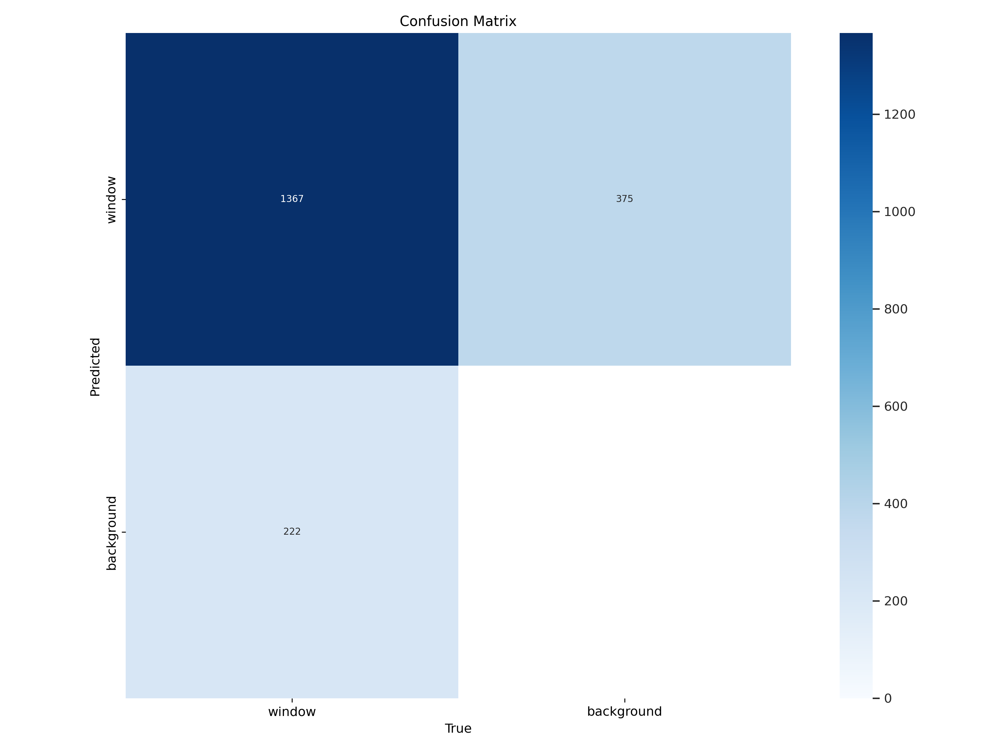

In [ ]:
image_path = '/content/drive/MyDrive/my_dataset_yolo/runs/detect/train/confusion_matrix.png'
image_caption = 'Ненормализованная матрица ошибок'

image_c = image_convert(image_path)
display(HTML(f"""
    <div style="text-align: center; margin-bottom: 20px;">
        <p style="font-size: 20px; font-weight: bold;">{image_caption}</p>
        <img src="data:image/jpeg;base64,{image_c}" alt="Image" style="max-width: 75%; height: auto;">
    </div>
    """))


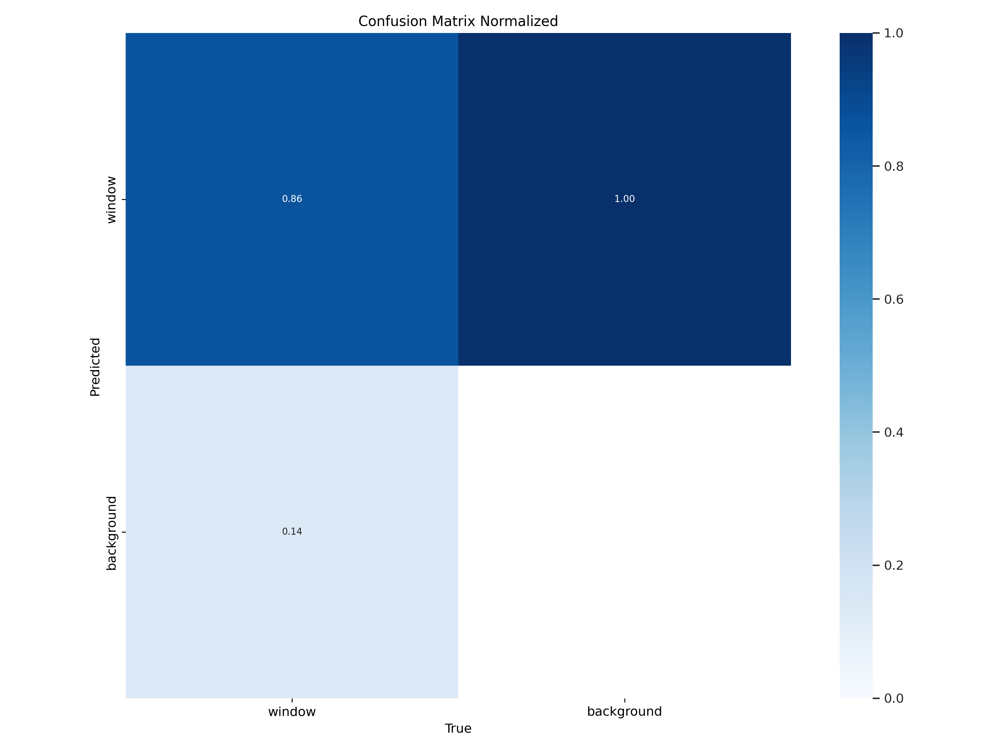

In [ ]:
image_path = '/content/drive/MyDrive/my_dataset_yolo/runs/detect/train/confusion_matrix_normalized.png'
image_caption = 'Нормализованная матрица ошибок'

image_c = image_convert(image_path)
display(HTML(f"""
    <div style="text-align: center; margin-bottom: 20px;">
        <p style="font-size: 20px; font-weight: bold;">{image_caption}</p>
        <img src="data:image/jpeg;base64,{image_c}" alt="Image" style="max-width: 75%; height: auto;">
    </div>
    """))


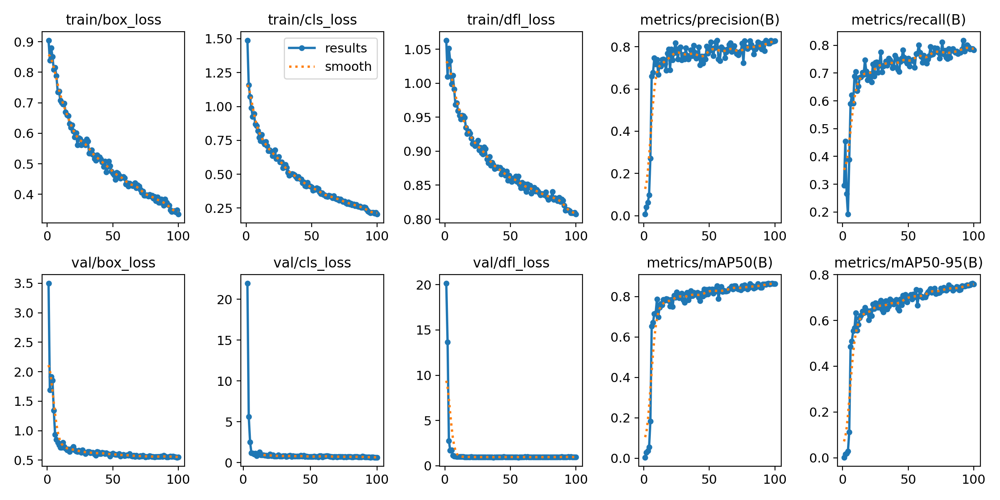

In [ ]:
image_path = '/content/drive/MyDrive/my_dataset_yolo/runs/detect/train/results.png'
image_caption = 'Результаты обучения'

image_c = image_convert(image_path)
display(HTML(f"""
    <div style="text-align: center; margin-bottom: 20px;">
        <p style="font-size: 20px; font-weight: bold;">{image_caption}</p>
        <img src="data:image/jpeg;base64,{image_c}" alt="Image" style="max-width: 90%; height: auto;">
    </div>
    """))


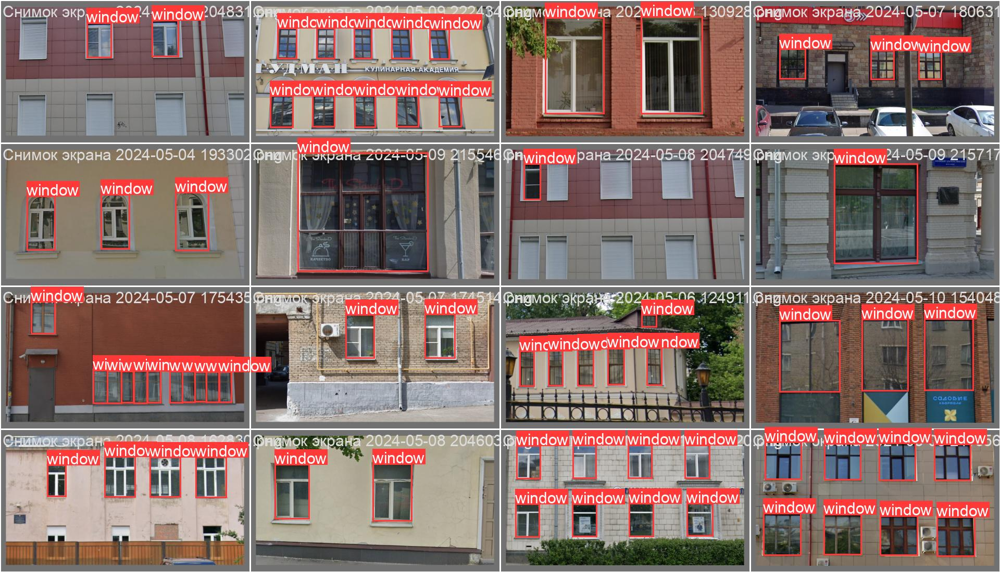

In [ ]:
image_path = '/content/drive/MyDrive/my_dataset_yolo/runs/detect/train/val_batch2_labels.jpg'
image_caption = 'Исходные данные'

image_c = image_convert(image_path)
display(HTML(f"""
    <div style="text-align: center; margin-bottom: 20px;">
        <p style="font-size: 20px; font-weight: bold;">{image_caption}</p>
        <img src="data:image/jpeg;base64,{image_c}" alt="Image" style="max-width: 75%; height: auto;">
    </div>
    """))


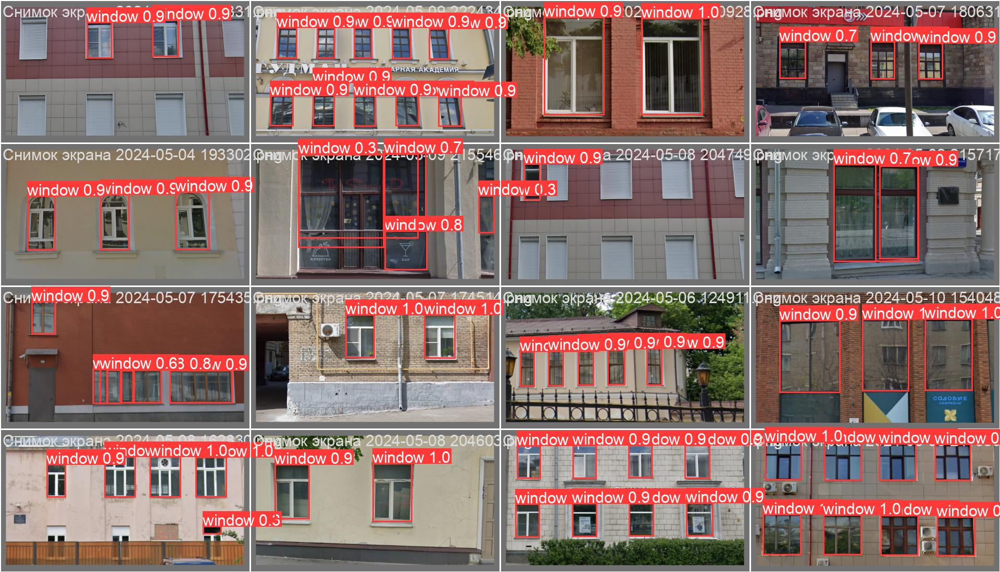

In [ ]:
image_path = '/content/drive/MyDrive/my_dataset_yolo/runs/detect/train/val_batch2_pred.jpg'
image_caption = 'Предсказанные данные'

image_c = image_convert(image_path)
display(HTML(f"""
    <div style="text-align: center; margin-bottom: 20px;">
        <p style="font-size: 20px; font-weight: bold;">{image_caption}</p>
        <img src="data:image/jpeg;base64,{image_c}" alt="Image" style="max-width: 75%; height: auto;">
    </div>
    """))

In [ ]:
model = YOLO('yolov9c.pt') # # Загрузка предобученной модели YOLOv9c
results = model.train(data='/content/drive/MyDrive/my_dataset_yolo/my_dataset_yolo.yaml', epochs=100, imgsz=640, model='yolov9c.pt') # Обучение модели на собственном наборе данных

Ultralytics YOLOv8.2.30 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov9c.pt, data=/content/drive/MyDrive/my_dataset_yolo/my_dataset_yolo.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show

100%|██████████| 755k/755k [00:00<00:00, 15.4MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  1    212864  ultralytics.nn.modules.block.RepNCSPELAN4    [128, 256, 128, 64, 1]        
  3                  -1  1    164352  ultralytics.nn.modules.block.ADown           [256, 256]                    
  4                  -1  1    847616  ultralytics.nn.modules.block.RepNCSPELAN4    [256, 512, 256, 128, 1]       
  5                  -1  1    656384  ultralytics.nn.modules.block.ADown           [512, 512]                    
  6                  -1  1   2857472  ultralytics.nn.modules.block.RepNCSPELAN4    [512, 512, 512, 256, 1]       
  7                  -1  1    656384  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 77.9MB/s]
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/my_dataset_yolo/labels/train... 765 images, 14 backgrounds, 0 corrupt: 100%|██████████| 765/765 [04:03<00:00,  3.14it/s]


train: New cache created: /content/drive/MyDrive/my_dataset_yolo/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/drive/MyDrive/my_dataset_yolo/labels/val... 255 images, 19 backgrounds, 0 corrupt: 100%|██████████| 265/265 [01:24<00:00,  3.15it/s]


val: New cache created: /content/drive/MyDrive/my_dataset_yolo/labels/val.cache
Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train3
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      11.5G     0.9247      1.659      1.111        133        640: 100%|██████████| 48/48 [01:19<00:00,  1.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:23<00:00,  2.56s/it]

                   all        265       1589     0.0138      0.251    0.00987    0.00548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      11.5G     0.9158        1.2      1.063        200        640: 100%|██████████| 48/48 [01:06<00:00,  1.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.16s/it]

                   all        265       1589    0.00381      0.191    0.00227   0.000673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      11.2G     0.9901      1.177       1.13         92        640: 100%|██████████| 48/48 [01:09<00:00,  1.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.12s/it]

                   all        265       1589     0.0309     0.0768     0.0144    0.00495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      11.3G     0.9566      1.093      1.114         91        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:21<00:00,  2.38s/it]

                   all        265       1589       0.32      0.285      0.198      0.106



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      11.2G     0.9096      1.015      1.066        252        640: 100%|██████████| 48/48 [01:06<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.12s/it]


                   all        265       1589     0.0563     0.0441     0.0184     0.0109

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      11.2G     0.8736       1.01      1.063        263        640: 100%|██████████| 48/48 [01:06<00:00,  1.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.10s/it]

                   all        265       1589      0.556      0.344      0.335      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      11.2G     0.8544     0.9382       1.04        125        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.23s/it]

                   all        265       1589      0.567      0.433       0.46       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      11.8G     0.8061     0.9274      1.018        124        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.33s/it]

                   all        265       1589       0.71      0.624      0.687      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      12.2G     0.7942     0.8928      1.014        313        640: 100%|██████████| 48/48 [01:02<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.28s/it]


                   all        265       1589      0.688      0.615      0.655      0.487

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      11.5G     0.7561     0.8289     0.9938        126        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.29s/it]

                   all        265       1589       0.76      0.661      0.714      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      11.8G     0.7572     0.8007     0.9964        162        640: 100%|██████████| 48/48 [01:03<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.31s/it]

                   all        265       1589      0.692      0.675      0.721      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      12.2G     0.7195     0.8417     0.9735        301        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:21<00:00,  2.39s/it]


                   all        265       1589      0.727      0.621      0.694      0.551

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      11.2G     0.7166     0.8213     0.9653        261        640: 100%|██████████| 48/48 [01:02<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.02s/it]

                   all        265       1589      0.721      0.686      0.746      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      11.5G     0.7024     0.7663     0.9764        135        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.11s/it]

                   all        265       1589      0.691      0.615      0.688      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      11.2G     0.6916      0.783     0.9736        103        640: 100%|██████████| 48/48 [01:04<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.28s/it]

                   all        265       1589      0.717      0.665      0.725      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      11.9G     0.6992     0.7448     0.9616        135        640: 100%|██████████| 48/48 [01:04<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.08s/it]

                   all        265       1589        0.7      0.717      0.741      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      11.2G     0.6639     0.7232     0.9487        164        640: 100%|██████████| 48/48 [01:04<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.15s/it]

                   all        265       1589      0.711      0.667      0.728      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      11.6G      0.661     0.7149     0.9634        124        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.05s/it]

                   all        265       1589      0.727      0.679      0.729      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      11.6G      0.644     0.6973     0.9501        246        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.14s/it]

                   all        265       1589      0.758       0.66      0.733      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      11.5G     0.6555     0.6949      0.954        130        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.21s/it]

                   all        265       1589        0.7      0.683      0.706      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      11.3G     0.6285     0.6798     0.9422        236        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.12s/it]


                   all        265       1589      0.744      0.656      0.709      0.575

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      11.8G     0.6547     0.7199      0.942        124        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.19s/it]

                   all        265       1589      0.613      0.613      0.651      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      11.5G     0.5977     0.6395     0.9365         89        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.12s/it]

                   all        265       1589      0.738      0.733       0.76       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      11.5G     0.6171     0.6381     0.9365        155        640: 100%|██████████| 48/48 [01:06<00:00,  1.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.11s/it]

                   all        265       1589      0.743      0.683      0.738      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      11.5G       0.61     0.6488     0.9368        163        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.24s/it]

                   all        265       1589      0.766      0.695      0.765      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      11.5G     0.5842     0.6156     0.9246        100        640: 100%|██████████| 48/48 [01:05<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.30s/it]

                   all        265       1589      0.775      0.696      0.773      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100        12G     0.6098     0.6265     0.9356        196        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.23s/it]

                   all        265       1589      0.733      0.665      0.741      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      12.7G     0.6042     0.5993     0.9206        134        640: 100%|██████████| 48/48 [01:02<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.24s/it]

                   all        265       1589      0.715      0.724      0.762      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      11.6G     0.5922      0.559     0.9134        220        640: 100%|██████████| 48/48 [01:06<00:00,  1.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.18s/it]

                   all        265       1589      0.769       0.71      0.782      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      11.4G     0.5984     0.5832     0.9292        135        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.23s/it]

                   all        265       1589      0.779      0.726      0.785      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      11.5G     0.5787     0.5625     0.9212        137        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:21<00:00,  2.36s/it]

                   all        265       1589      0.727      0.712      0.761      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      11.9G     0.5609     0.5295     0.9107        237        640: 100%|██████████| 48/48 [01:01<00:00,  1.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.28s/it]

                   all        265       1589      0.775      0.736      0.799      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      11.6G     0.5689     0.5069     0.9028        192        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.17s/it]

                   all        265       1589      0.667      0.754      0.749      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      11.2G     0.5689     0.5296     0.9127        147        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.13s/it]

                   all        265       1589      0.783      0.744      0.799      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      11.3G     0.5575     0.5215     0.9004        204        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.11s/it]

                   all        265       1589      0.699      0.717      0.734      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      11.2G      0.537     0.5224     0.8984        136        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.20s/it]

                   all        265       1589      0.771      0.731      0.781      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      12.2G     0.5278     0.4929     0.8929        167        640: 100%|██████████| 48/48 [01:06<00:00,  1.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.05s/it]

                   all        265       1589      0.751      0.727      0.772      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      11.4G     0.5524     0.4925     0.8976        200        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.29s/it]

                   all        265       1589        0.7      0.748      0.767      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      11.6G     0.5403     0.4994     0.8986         90        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.29s/it]

                   all        265       1589      0.698      0.735      0.761      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      11.5G     0.5409     0.5146     0.8965        101        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.07s/it]

                   all        265       1589      0.779      0.731      0.787      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      11.5G     0.5456     0.5046     0.8983         83        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.15s/it]

                   all        265       1589      0.743      0.735      0.782      0.656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      11.4G     0.5335     0.4933     0.8987        130        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.23s/it]

                   all        265       1589      0.785      0.715      0.796      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      11.5G     0.5243     0.4615     0.8931        191        640: 100%|██████████| 48/48 [01:04<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.18s/it]

                   all        265       1589      0.633       0.76      0.743      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      11.2G     0.5339     0.4768     0.8961         97        640: 100%|██████████| 48/48 [01:04<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.32s/it]


                   all        265       1589      0.694      0.747       0.75      0.628

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      11.2G     0.4994     0.4638     0.8903        265        640: 100%|██████████| 48/48 [01:06<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.13s/it]

                   all        265       1589      0.689      0.766      0.778      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      11.6G     0.5042     0.4518     0.8842         89        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:21<00:00,  2.34s/it]

                   all        265       1589      0.705      0.774      0.793      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      11.2G     0.5208     0.4381     0.8894        171        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.11s/it]

                   all        265       1589      0.771      0.738      0.788      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      11.6G     0.5217     0.4337     0.8825        142        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.21s/it]


                   all        265       1589      0.705      0.765      0.779      0.654

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100        12G     0.4979     0.4364      0.879        213        640: 100%|██████████| 48/48 [01:02<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.14s/it]

                   all        265       1589      0.718      0.731      0.782      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      11.9G     0.4872     0.4197     0.8771        131        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.07s/it]


                   all        265       1589      0.769      0.748      0.801      0.688

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      11.2G     0.4941     0.4033     0.8775        144        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.19s/it]

                   all        265       1589      0.775      0.705      0.767      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      11.6G     0.4724     0.4149     0.8824         90        640: 100%|██████████| 48/48 [01:01<00:00,  1.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.22s/it]

                   all        265       1589      0.778      0.743      0.807      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      11.9G      0.497     0.4251     0.8802        119        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.19s/it]

                   all        265       1589      0.788      0.743      0.801      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      11.6G     0.4877     0.4275     0.8855         99        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.17s/it]

                   all        265       1589      0.806      0.736       0.81      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      11.5G     0.4842     0.4091     0.8747        186        640: 100%|██████████| 48/48 [01:06<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.09s/it]

                   all        265       1589      0.788      0.756      0.808      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      11.5G     0.4684      0.391     0.8778        116        640: 100%|██████████| 48/48 [01:06<00:00,  1.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.16s/it]

                   all        265       1589      0.813       0.72      0.799       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      11.5G     0.4664     0.3713     0.8696        251        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.12s/it]

                   all        265       1589      0.696      0.775      0.781       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      11.6G     0.4772     0.3843     0.8618        187        640: 100%|██████████| 48/48 [01:08<00:00,  1.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.25s/it]

                   all        265       1589      0.734      0.769      0.804      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      11.5G     0.4761     0.3734     0.8702        115        640: 100%|██████████| 48/48 [01:06<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.24s/it]

                   all        265       1589      0.775      0.737      0.809      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      11.2G     0.4639     0.3673      0.866        157        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.31s/it]

                   all        265       1589      0.759       0.74      0.807       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      11.8G      0.458     0.3563     0.8676        164        640: 100%|██████████| 48/48 [01:06<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.12s/it]

                   all        265       1589      0.773      0.756      0.797      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      11.1G     0.4526     0.3485     0.8587        138        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.28s/it]


                   all        265       1589      0.724      0.777      0.785      0.671

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      11.2G     0.4576     0.3707     0.8667        174        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.14s/it]

                   all        265       1589      0.716       0.76      0.772      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      12.4G     0.4512     0.3541     0.8614        122        640: 100%|██████████| 48/48 [01:06<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:21<00:00,  2.35s/it]

                   all        265       1589      0.705      0.757       0.76      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      11.9G     0.4495     0.3584     0.8642        111        640: 100%|██████████| 48/48 [01:04<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.21s/it]


                   all        265       1589      0.761      0.753      0.798      0.691

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      11.9G      0.449     0.3468     0.8539         76        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.16s/it]

                   all        265       1589       0.81      0.742      0.804      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      11.8G     0.4537     0.3623     0.8591        135        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.11s/it]

                   all        265       1589      0.744      0.756      0.799      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      11.6G      0.437     0.3364     0.8613        143        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.24s/it]


                   all        265       1589      0.762      0.765      0.808      0.702

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      11.5G     0.4487     0.3313     0.8538        148        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.03s/it]

                   all        265       1589      0.774      0.741      0.802       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      12.1G     0.4444     0.3452     0.8563        123        640: 100%|██████████| 48/48 [01:05<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:21<00:00,  2.34s/it]

                   all        265       1589      0.752      0.761      0.796      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      11.8G     0.4295     0.3234      0.855        162        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.16s/it]


                   all        265       1589      0.728      0.769      0.774      0.671

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      11.9G     0.4223     0.3262     0.8555        148        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.08s/it]

                   all        265       1589        0.8      0.728      0.809      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      11.5G     0.4283     0.3211     0.8484        100        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.08s/it]

                   all        265       1589      0.758      0.766      0.808      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      11.1G     0.4149     0.3171     0.8472        142        640: 100%|██████████| 48/48 [01:03<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.19s/it]

                   all        265       1589      0.804      0.729      0.806      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      11.6G      0.419     0.3207      0.849        132        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.09s/it]

                   all        265       1589      0.769      0.743      0.802      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      11.2G     0.4149     0.3113     0.8474        146        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.07s/it]

                   all        265       1589      0.785      0.722      0.803      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      11.6G     0.4108      0.298     0.8499         78        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.30s/it]

                   all        265       1589      0.771       0.77      0.823      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      11.9G     0.4153      0.314     0.8433        109        640: 100%|██████████| 48/48 [01:08<00:00,  1.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.15s/it]

                   all        265       1589      0.758      0.762      0.799       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      11.9G     0.4148     0.3075     0.8371        115        640: 100%|██████████| 48/48 [01:04<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.19s/it]

                   all        265       1589       0.81      0.729      0.811      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      11.2G     0.4112     0.2999     0.8373        109        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.12s/it]

                   all        265       1589      0.826      0.731      0.819      0.712



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      11.1G     0.4049     0.2869     0.8408        193        640: 100%|██████████| 48/48 [01:04<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.25s/it]

                   all        265       1589      0.829      0.746      0.826      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      11.5G     0.4106     0.2942     0.8505        111        640: 100%|██████████| 48/48 [01:07<00:00,  1.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:21<00:00,  2.34s/it]

                   all        265       1589      0.778      0.765      0.806      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      11.6G     0.4014      0.284     0.8409        154        640: 100%|██████████| 48/48 [01:08<00:00,  1.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:21<00:00,  2.42s/it]

                   all        265       1589       0.77      0.768      0.803      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      11.8G     0.4054     0.2833     0.8415        119        640: 100%|██████████| 48/48 [01:05<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:21<00:00,  2.39s/it]

                   all        265       1589      0.789       0.75      0.809      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      11.3G     0.3916     0.2802     0.8409        140        640: 100%|██████████| 48/48 [01:06<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.22s/it]

                   all        265       1589      0.763      0.778      0.816      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      11.3G     0.3903     0.2732     0.8368        153        640: 100%|██████████| 48/48 [01:06<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:22<00:00,  2.45s/it]

                   all        265       1589      0.784      0.745      0.805      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      11.2G     0.3973      0.273     0.8404        292        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:21<00:00,  2.41s/it]

                   all        265       1589      0.803      0.757      0.813      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      11.7G      0.383     0.2656     0.8343        140        640: 100%|██████████| 48/48 [01:07<00:00,  1.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:21<00:00,  2.44s/it]

                   all        265       1589      0.781      0.756      0.815      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      11.2G     0.3785     0.2637     0.8386        130        640: 100%|██████████| 48/48 [01:02<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.31s/it]

                   all        265       1589      0.751      0.782      0.811      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      11.5G     0.3962     0.2659     0.8349        150        640: 100%|██████████| 48/48 [01:04<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.17s/it]

                   all        265       1589      0.771      0.763      0.813      0.711


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      11.5G     0.3839     0.2609     0.8263        154        640: 100%|██████████| 48/48 [01:09<00:00,  1.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.16s/it]

                   all        265       1589      0.755      0.775      0.809      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      11.5G      0.376     0.2422      0.819         60        640: 100%|██████████| 48/48 [01:05<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.26s/it]

                   all        265       1589      0.726      0.784      0.794      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      11.5G     0.3775     0.2379     0.8203        120        640: 100%|██████████| 48/48 [01:02<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.14s/it]

                   all        265       1589      0.759      0.756      0.802      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      11.1G     0.3609     0.2292     0.8218        135        640: 100%|██████████| 48/48 [01:04<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.14s/it]

                   all        265       1589      0.756       0.79       0.81      0.712



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      11.5G     0.3586     0.2256     0.8183         49        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.13s/it]

                   all        265       1589      0.749      0.788      0.801      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      11.4G     0.3594     0.2263     0.8181         71        640: 100%|██████████| 48/48 [01:04<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:18<00:00,  2.02s/it]

                   all        265       1589      0.763      0.779      0.804      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      11.5G     0.3564     0.2249     0.8129         68        640: 100%|██████████| 48/48 [01:02<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:19<00:00,  2.16s/it]


                   all        265       1589      0.764      0.775        0.8      0.703

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100        12G     0.3548     0.2226     0.8151         59        640: 100%|██████████| 48/48 [01:03<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.30s/it]


                   all        265       1589       0.77      0.763      0.797      0.701

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      11.9G       0.36     0.2204     0.8147        156        640: 100%|██████████| 48/48 [01:03<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:20<00:00,  2.28s/it]

                   all        265       1589      0.754      0.772      0.797        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      11.8G     0.3479     0.2158     0.8117         56        640: 100%|██████████| 48/48 [01:02<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:17<00:00,  1.97s/it]

                   all        265       1589      0.748      0.773      0.797        0.7



100 epochs completed in 2.481 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 51.6MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 51.6MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics YOLOv8.2.30 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv9c summary (fused): 384 layers, 25320019 parameters, 0 gradients, 102.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:23<00:00,  2.60s/it]


                   all        265       1589      0.829      0.747      0.826      0.717
Speed: 0.5ms preprocess, 13.8ms inference, 0.1ms loss, 7.9ms postprocess per image
Results saved to runs/detect/train3



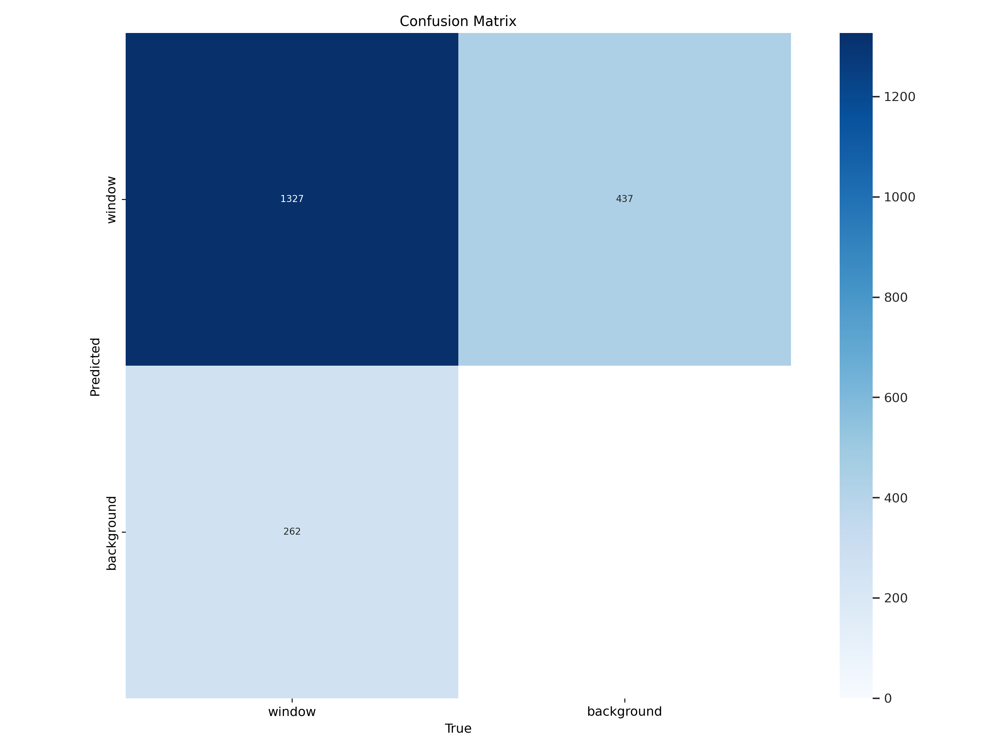

In [ ]:
image_path = '/content/drive/MyDrive/my_dataset_yolo/confusion_matrix.png'
image_caption = 'Ненормализованная матрица ошибок'

image_c = image_convert(image_path)
display(HTML(f"""
    <div style="text-align: center; margin-bottom: 20px;">
        <p style="font-size: 20px; font-weight: bold;">{image_caption}</p>
        <img src="data:image/jpeg;base64,{image_c}" alt="Image" style="max-width: 75%; height: auto;">
    </div>
    """))


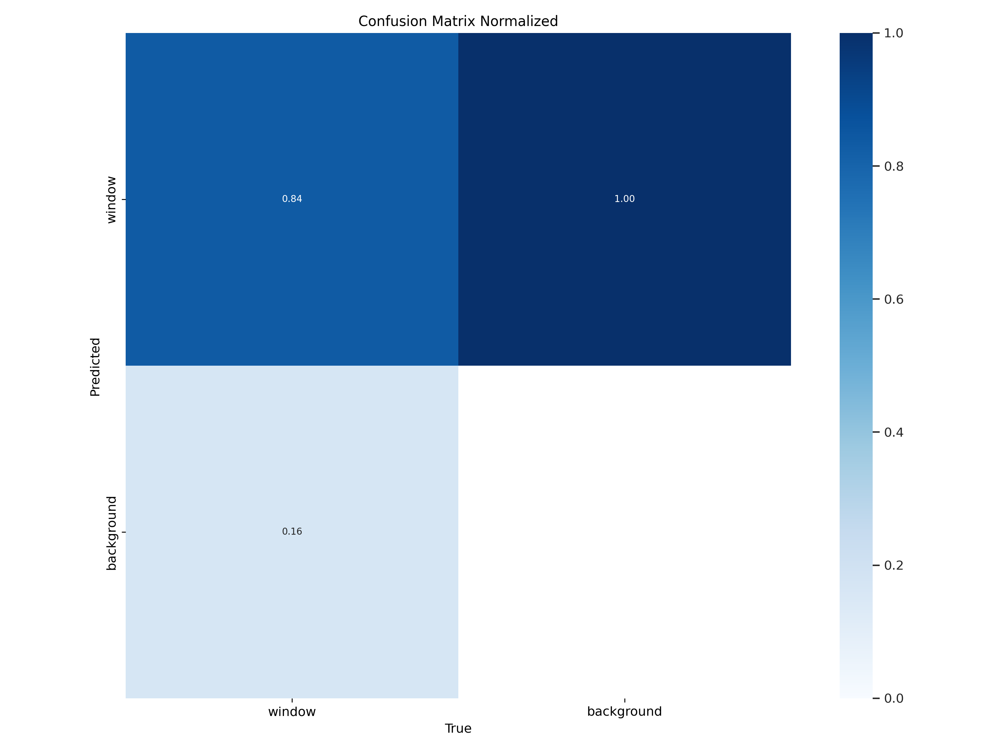

In [ ]:
image_path = '/content/drive/MyDrive/my_dataset_yolo/confusion_matrix_normalized.png'
image_caption = 'Нормализованная матрица ошибок'

image_c = image_convert(image_path)
display(HTML(f"""
    <div style="text-align: center; margin-bottom: 20px;">
        <p style="font-size: 20px; font-weight: bold;">{image_caption}</p>
        <img src="data:image/jpeg;base64,{image_c}" alt="Image" style="max-width: 75%; height: auto;">
    </div>
    """))


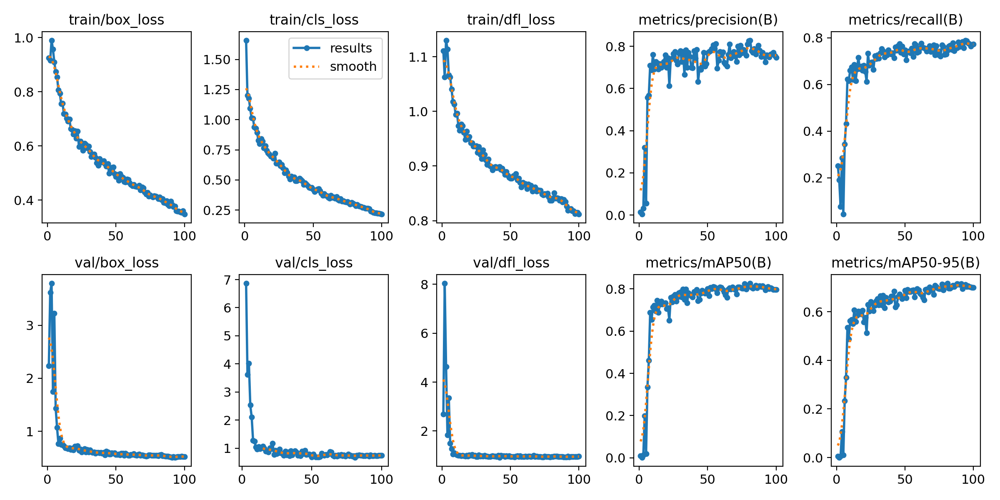

In [ ]:
image_path = '/content/drive/MyDrive/my_dataset_yolo/results.png'
image_caption = 'Нормализованная матрица ошибок'

image_c = image_convert(image_path)
display(HTML(f"""
    <div style="text-align: center; margin-bottom: 20px;">
        <p style="font-size: 20px; font-weight: bold;">{image_caption}</p>
        <img src="data:image/jpeg;base64,{image_c}" alt="Image" style="max-width: 90%; height: auto;">
    </div>
    """))


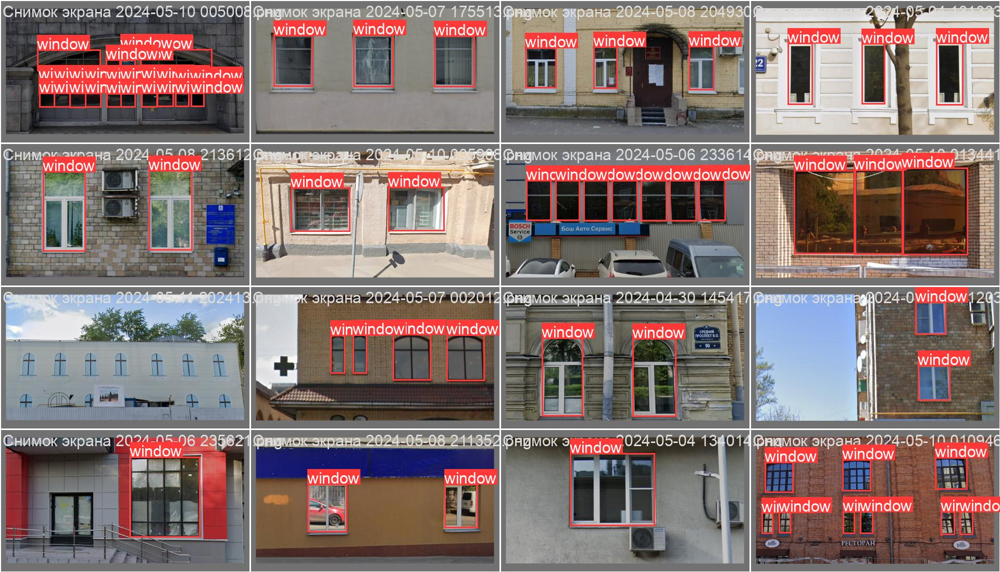

In [ ]:
image_path = '/content/drive/MyDrive/my_dataset_yolo/val_batch1_labels.jpg'
image_caption = 'Исходные данные'

image_c = image_convert(image_path)
display(HTML(f"""
    <div style="text-align: center; margin-bottom: 20px;">
        <p style="font-size: 20px; font-weight: bold;">{image_caption}</p>
        <img src="data:image/jpeg;base64,{image_c}" alt="Image" style="max-width: 75%; height: auto;">
    </div>
    """))


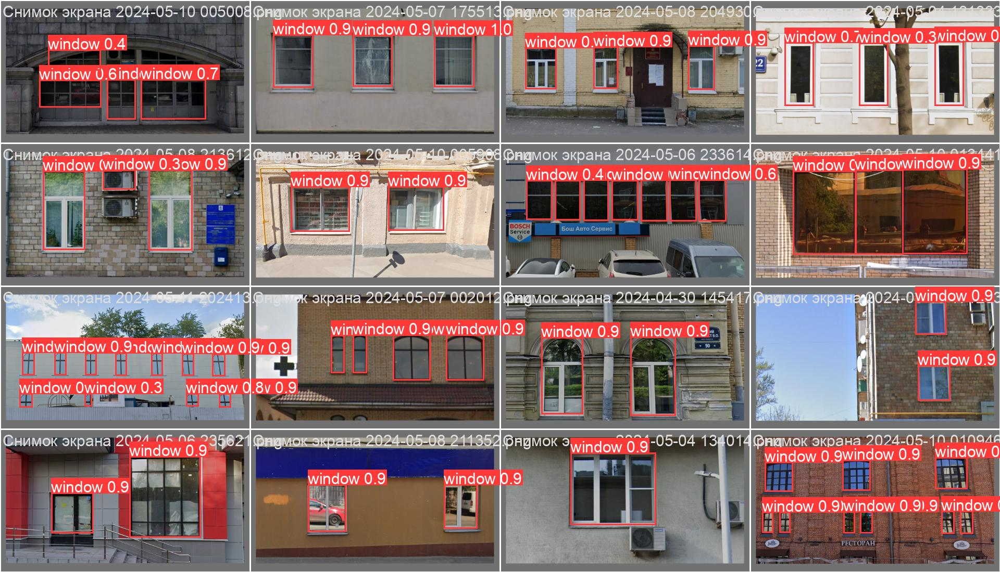

In [ ]:
image_path = '/content/drive/MyDrive/my_dataset_yolo/val_batch1_pred.jpg'
image_caption = 'Предсказанные данные'

image_c = image_convert(image_path)
display(HTML(f"""
    <div style="text-align: center; margin-bottom: 20px;">
        <p style="font-size: 20px; font-weight: bold;">{image_caption}</p>
        <img src="data:image/jpeg;base64,{image_c}" alt="Image" style="max-width: 75%; height: auto;">
    </div>
    """))

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs/detect/train3

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

# Оценка модели и результатов

In [4]:
# Импорт библиотек
from ultralytics import YOLO
import cv2
import random
import os

def track_video(model, source_video_path, output_file="output_video.mp4"):
    # Открытие видеофайла для чтения
    video_capture = cv2.VideoCapture(source_video_path)

    if not video_capture.isOpened():
        raise RuntimeError("Unable to open the input video file")

    # Получение параметров видео
    frame_rate = int(video_capture.get(cv2.CAP_PROP_FPS))
    frame_width = int(video_capture.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(video_capture.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Настройка видеокодека и выходного видеофайла
    video_codec = cv2.VideoWriter_fourcc(*'mp4v')
    video_writer = cv2.VideoWriter(output_file, video_codec, frame_rate, (frame_width, frame_height))

    # Цикл для чтения и обработки кадров видео
    while True:
        ret, frame = video_capture.read()
        if not ret:
            break

        # Обработка кадра с использованием модели YOLO
        results = model.track(frame, iou=0.5, conf=0.5, persist=True, imgsz=640, verbose=False, tracker="botsort.yaml")
        if results[0].boxes.id is not None:
            bounding_boxes = results[0].boxes.xyxy.cpu().numpy().astype(int)
            object_ids = results[0].boxes.id.cpu().numpy().astype(int)

            # Отрисовка bounding_boxes и индексов объектов на кадре
            for bbox, obj_id in zip(bounding_boxes, object_ids):
                random.seed(int(obj_id))
                box_color = (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))

                # Отображение прямоугольника и индекса объекта на кадре
                cv2.rectangle(frame, (bbox[0], bbox[1]), (bbox[2], bbox[3]), box_color, 2)
                cv2.putText(frame, f"ObjID: {obj_id}", (bbox[0], bbox[1] - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, box_color, 2)

        video_writer.write(frame)

    video_capture.release()
    video_writer.release()
    cv2.destroyAllWindows()

# Загрузка и подготовка модели YOLO
#model = YOLO("/content/drive/MyDrive/my_dataset_yolo/runs/detect/train/weights/best.pt")
model = YOLO("/content/drive/MyDrive/my_dataset_yolo/runs/detect/train/weights/best_9.pt")
model.fuse()

# Вызов функции для обработки видео
track_video(model, source_video_path="/content/drive/MyDrive/example.mp4", output_file="output_video.mp4")

YOLOv9c summary (fused): 384 layers, 25320019 parameters, 0 gradients, 102.3 GFLOPs


Можно видеть, что модели показали схожие результаты, однако YOLOv8m продемонстировала немного более высокие значения метрик. В данной задаче YOLOv8m является оптимальным выбором благодаря балансу между точностью и вычислительной эффективностью. Несмотря на схожее количество параметров, YOLOv9c обладает большей вычислительной сложностью из-за большего количества FLOPs (78.9 у YOLOv8m и 102.8 у YOLOv9c). Для улучшения результата можно предпринять следующие шаги: увеличения и аугментация данных, тонкая настройка гиперпараметров и архитектуры модели.